In [2]:
"""single_cell_nsclc"""
__author__      = "Thomas Dupic"

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import workflow
import matplotlib.cm as cm
import scipy.cluster.hierarchy as hc
import scipy.spatial
from collections import defaultdict, Counter
from matplotlib.lines import Line2D
from tqdm import tqdm_notebook as tqdm
from itertools import product
import networkx as nx
from IPython.display import set_matplotlib_formats
import matplotlib
import matplotlib.cm as cm
matplotlib.rcParams['figure.dpi'] = 300


# Official clusters names, with the associated colors
old_name_lst = ["CD4 CD69", "CD4 Naive", "CD4 memory", "Stressed CD4 memory",
            "CD4 GZMA", "MAIT", "CD8 ZNF683", "Tregs 1", "CD8 GZMH",
            "CD8 GZMK 1", "Tfh 1", "Tregs 2", "Tfh 2", "CD8 GZMK 2",
            "CD8 LAYN", "GDT cells", "Tregs 3", "Cycling 1", "Cycling 2",
            "IFN", "CD8 effectors", "Unassigned"]

official_name_lst = ["CD4-CD69", "CD4-SELL", "CD4-IL7R", "CD4-HSPH1", "CD4-GZMA",
                 "CD8-SLC4A10", "CD8-XCL1", "CD4-IL32", "CD8-GZMH", "CD8-KLF2",
                 "CD4-SESN1", "CD4-CCR8", "CD4-TNFRSF18", "CD8-GZMK", "CD8-LAYN",
                 "CD3-TRDC", "CD4-MAL", "CD4/8-TOP2A", "CD4/8-MCM5",
                 "CD4/8-ISG15", "CD8-FCGR3A", "Unassigned"]

cd8_clusters = [ "CD8-SLC4A10", "CD8-XCL1","CD8-GZMH", "CD8-KLF2",
                 "CD8-GZMK", "CD8-LAYN",
                 "CD3-TRDC", "CD4/8-TOP2A", "CD4/8-MCM5",
                 "CD4/8-ISG15", "CD8-FCGR3A", "Unassigned"]

color_lst = ["#5A5156", "#0000CD", "#F6222E", "#FE00FA", "#16FF32", "#3283FE", "#FEAF16",
          "#B00068", "#1CFFCE", "#90AD1C", "#2ED9FF", "#DEA0FD", "#AA0DFE", "#F8A19F",
          "#325A9B", "#C4451C", "#1C8356", "#85660D", "#B10DA1", "#FBE426", "#1CBE4F", "#C7C7C7"]

order = ["CD8-FCGR3A", "CD3-TRDC", "CD8-KLF2", "CD8-GZMK",
         "CD8-GZMH", "CD8-LAYN", "CD8-XCL1", "CD8-SLC4A10",
         "CD4/8-ISG15", "CD4/8-TOP2A", "CD4/8-MCM5", "CD4-SELL",
         "CD4-IL7R", "CD4-HSPH1", "CD4-CD69", "CD4-GZMA", "CD4-SESN1",
         "CD4-TNFRSF18", "CD4-IL32", "CD4-CCR8", "CD4-MAL"]


official_name = dict(zip(old_name_lst, official_name_lst))
color = dict(zip(official_name_lst, color_lst))

/home/thomas/.local/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


## All tumors 

In [11]:
# load the .rdata file containing the clustering
# information and extract it
rdata = "../Data/Paul/CD3_11tumors_subset"
keys = ["P47_Tumor", "P55_Tumor", "P57_Tumor", "P58_Tumor", "P60_Tumor", "P61_Tumor"]
df_seq = {}
for key in tqdm(keys):
    
    # load clonotypes information from 10X
    df_seq[key] = pd.read_csv("../Data/" + key + 
                              "_VDJ/outs/filtered_contig_annotations_mixcr.csv")
    df_seq[key]["patient"] = key.split("_")[0]
    
    # load clustering information from the rdata
    df_seq[key] = workflow.add_cluster_info(df_seq[key],
                               rdata + "_clusters.csv",
                               key[:3],
                               name_column="cluster", 
                               metadata=rdata + "_metadata.csv",
                               umap=rdata + "_umap.csv", 
                               cca=rdata + "_pca.csv")

    # add the patient name to the clonotypes & 
    # barcodes to make them patient specific
    df_seq[key]["barcode"] = df_seq[key]["Unnamed: 0"].apply(lambda x: key + ":" + x[:16])
    df_seq[key]["raw_clonotype_id"] = df_seq[key].raw_clonotype_id.apply(lambda x: str(x) + "_" + key)
    # replace the old cluster names by the "official" clusters names
    df_seq[key]["cluster"] = df_seq[key].cluster.map(official_name)

df_all = pd.concat([df_seq[k] for k in keys], sort=False)
df_all["clonotype"] = df_all.raw_clonotype_id # choose the clonotype def of 10X

/home/thomas/.local/lib/python3.6/site-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


### Fig 4.B

/users/dupic/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:35: RuntimeWarning: invalid value encountered in double_scalars


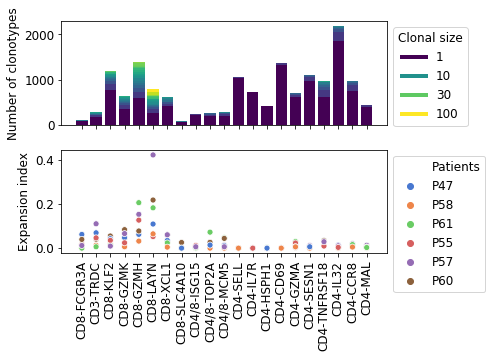

In [42]:
df = df_all.copy()
# again, remove the cells without a clonotype
df = df[df.clonotype.apply(lambda x: "None" not in x)]



# first plot, barplot
dffig = df.groupby(["clonotype", "cluster"]).barcode.nunique().to_frame("Clonal_size").reset_index()
dffig["Clusters"] = dffig.cluster
dffig["clust_nb"] = dffig.Clusters.map(dict(zip(order, range(len(order)))))
dffig["Number_of_cells"] = dffig.Clonal_size
dffig.sort_values(by="Clonal_size", inplace=True)
dftmp = pd.DataFrame()
for c in order:
    dftmp2 = dffig[dffig.Clusters == c].copy()
    dftmp2["height"] = dftmp2.Number_of_cells.cumsum()
    dftmp = pd.concat([dftmp2, dftmp])
dffig = dftmp.copy()
dffig["invClonalsize"] = -dffig.Clonal_size
dffig.sort_values(by=["clust_nb", "invClonalsize"], inplace=True)

entropy, cluster, patient = {}, {}, {}
i = 0
# compute the expansion index
for k in keys:
    for c in order:
        dfc = df[(df.cluster == c) &  (df.patient == k.split('_')[0])]
        lst = list(dfc.groupby("clonotype").barcode.nunique()/dfc.barcode.nunique())
        lst.sort(reverse=True)
        entropy[i] = 1 + np.sum([a*np.log(a) for a in lst])/(np.log(len(lst)))
        cluster[i] = c
        patient[i] = k.split("_")[0]
        i += 1
dfp = pd.DataFrame().from_dict({"entropy":entropy, "cluster":cluster, "patient":patient})

# fix the order (first by cluster, then by clonal size)
dfp["clust_nb"] = dfp.cluster.map(dict(zip(order, range(len(order)))))
dfp.sort_values(by="clust_nb", inplace=True)

cmap=cm.viridis
plt.rcParams.update({'font.size': 12})
fig, (ax1, ax2) = plt.subplots(2, 1,figsize=(7, 5), sharex=True)

ax1.bar(x=dffig["Clusters"], height=dffig["height"],
        color=cmap(np.log(dffig["Clonal_size"])
                   /np.log(np.max(dffig.Clonal_size))),
        data=dffig)
custom_lines = [Line2D([0], [0], color=cmap(0), lw=4),
                Line2D([0], [0], color=cmap(0.5), lw=4),
                Line2D([0], [0], color=cmap(0.75), lw=4),
                Line2D([0], [0], color=cmap(1.), lw=4)
               ]
ax1.set_ylabel("Number of clonotypes")
ax1.legend(custom_lines, ["1", "10", "30", "100"],
           title="Clonal size",
           bbox_to_anchor=(1., 1.))


ax2 = sns.scatterplot(x="cluster", y="entropy", 
                      hue="patient", data=dfp, 
                      palette="muted", ax=ax2)

l = ax2.legend(bbox_to_anchor=(1., 1.))
l.get_texts()[0].set_text('Patients')
plt.draw()
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90, ha="center")
ax2.set_ylabel("Expansion index")
ax2.set_xlabel("")

plt.tight_layout()
plt.show()


### Fig 4.D

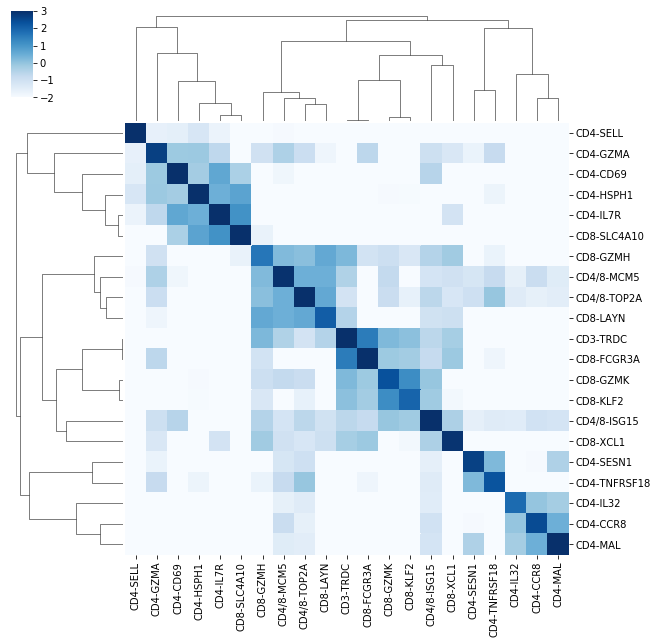

In [11]:
df = df_all.copy()

# limit the search to TRB sequences only (usually present in only one copy in the cell)
df = df[df.chain == "TRB"]

# remove the cells for which we don't have the cluster or the clonotype info
df = df.dropna(subset=["cluster"])
df = df[df.clonotype.apply(lambda x: "None" not in x)]

# only keep the clonotypes that contains more than one cell
vc_clone = df.clonotype.value_counts()
multiples = [k for k, a in vc_clone.items() if a > 1]
df = df[df.clonotype.isin(multiples)]


clusters = df.cluster.unique()
clusters.sort()
size_clusters = {k: v for k, v in df.cluster.value_counts().items()}

gpby_clonotype = df.groupby("clonotype").cluster.apply(list)
# only keep the clonotypes with more than one cell
gpby_clonotype = gpby_clonotype[gpby_clonotype.apply(len) > 1].copy()

 
# Algorithm explanation:
# For a given cell in c1, we count the number of cells in c2 (!= from the first cell)
# in the same clonotype, and divide by the length of the clonotype minus one
# this proba is then divided by the total number of cells in the cluster c1
proba = {}
for c1 in clusters:
    for c2 in clusters:
        proba[c1, c2] = np.sum(gpby_clonotype.apply(
            lambda x: x.count(c1)*(x.count(c2) - (1 if c2 == c1 else 0))/(len(x) - 1)
        ))/(size_clusters[c1])

# Same computation, but this time the cluster are randomized
proba_random = {k:0 for k in proba.keys()}
nb_replicas = 10 # do it a few time to get a solid mean
for _ in range(nb_replicas): 
    df["random_cluster"] = np.random.permutation(df.cluster)
    gpby_clonotype = df.groupby("clonotype").random_cluster.apply(list)
    for c1 in clusters:
        for c2 in clusters:
            proba_random[c1, c2] += np.sum(gpby_clonotype.apply(
                lambda x: x.count(c1)*(x.count(c2) - (1 if c2 == c1 else 0))/(len(x) - 1)
        ))/size_clusters[c1]/nb_replicas          


result = {}
for c1 in clusters:
    for c2 in clusters:
            result[c1, c2] = (proba[c1, c2])/proba_random[c1, c2]


# reshape the dataframe and to plot it in a heatmap
df_shared_clonotype = pd.Series(result)
L = clusters
mux = pd.MultiIndex.from_product([L, L], names=df_shared_clonotype.index.names)
df_shared_clonotype = df_shared_clonotype.reindex(mux)
# we plot the logarithm of the ratio, rather than just the ratio
df_shared_clonotype = df_shared_clonotype.apply(lambda x: np.log(x + 1e-10))
df_ustack = df_shared_clonotype.unstack()
df_ustack = df_ustack[L]
df_ustack = df_ustack.reindex(L)

# the clustermap needs a distance matrix (symmetric)
mat = df_ustack.values
mat = np.exp(-np.exp(mat))
mat = np.nan_to_num(mat) # replace the "not-a-number" by 0
linkage = hc.linkage(scipy.spatial.distance.squareform(mat + np.transpose(mat) - 2*np.diag(np.diag(mat))
), method='average')

clustergrid = sns.clustermap(df_ustack, row_linkage=linkage, col_linkage=linkage,cmap="Blues", vmin=-2, vmax=3)

plt.show()


### Fig 4 E

In [127]:
df = df_all.copy()

df.dropna(subset=["cluster"], inplace=True)
dct_patient = dict(zip(df.patient.unique(), range(len(df.patient.unique()))))
inv_dct_patient = {dct_patient[a]:a for a in dct_patient}
df["patient_nb"] = df.patient.map(dct_patient)



order_CD8 = ["CD8-GZMK", "CD8-KLF2", "CD3-TRDC", "CD8-FCGR3A",
             "CD4/8-MCM5", "CD4/8-TOP2A", "CD4/8-ISG15", 
             "CD8-XCL1", "CD8-LAYN", "CD8-GZMH"]
clusters = [(k,o) for k,o in enumerate(order_CD8)]
dct_clusters = {o:k for k,o in enumerate(order_CD8)}

df = df[df.cluster.isin(order_CD8)].copy()
clusters_gb = df.groupby("clonotype").cluster.apply(list)
patients_dct = df.groupby("clonotype").patient_nb.first().to_dict()
source = []
target = []
patients = []
for clo, clus in clusters_gb.iteritems():
    cnt = Counter(clus)
    mc = cnt.most_common(2)
    if len(mc) > 1 and (mc[0][1] >= 1 and mc[1][1] >= 1):
        source.append(mc[0][0] + "_" + clo)
        target.append(mc[1][0] + "_" + clo)
        source.append(mc[1][0] + "_" + clo)
        target.append(mc[0][0] + "_" + clo)
        patients.append(patients_dct[clo])
        patients.append(patients_dct[clo])
        
        

df_circo = pd.DataFrame({"source": source, "target":target, "patient": patients})
df_circo["cluster"] = df_circo.source.apply(
    lambda x: x.split("_")[0])
df_circo["tgt_cluster"] = df_circo.target.map(
    df_circo.set_index("source").cluster)
df_circo = df_circo.sort_values(by="patient")


palette = sns.color_palette([color[a] for a in order_CD8])
fig, ax = plt.subplots(figsize=(40,40))
dfres = workflow.chord_diagram("source", "target", hue="cluster", hue_order=order_CD8,
                      palette=palette, data=df_circo, ax=ax, chord_args={'linewidth':4},
                     text_args={'fontsize':60}, radius_text=1.58, no_chords=False, sub_circle=True, spacing=0.01, spacing_sub=0.002,
                      thickness_circle=0.02, threshold=0.,
                      additional_circle="patient", spacing_add=0.015, thickness_add_circle=0.1, palette_add_circle=sns.color_palette("muted")
                     )

custom_lines = []
for ii in range(len(df.patient.unique())):
    custom_lines.append(Line2D([0], [0], color=sns.color_palette("muted")[ii], lw=30))
ax.legend(custom_lines,
          [inv_dct_patient[ii] 
           for ii in range(len(df.patient.unique()))], 
          loc="upper right", prop={'size': 50})
plt.tight_layout()
plt.savefig("Fig4E.png", bbox_inches='tight', dpi=100)
plt.show()

### Fig 4 F

[0.1765242324902676, 0.7618447354934783, 0.3091256407659886, 0.10912543845438893, 0.12539302865892565, 0.06691906076647632, 0.058430607110243254, 0.5908363041617279, 0.06852978760990391]


/users/dupic/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


(-3.0, 2.5, -3.0, 2.5)

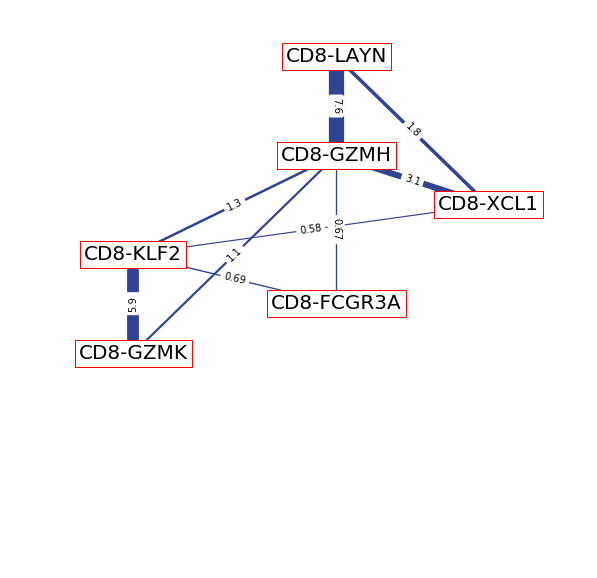

In [56]:
df = df_all.copy()
entropy = {}

df = df.dropna(subset=["cluster", "clonotype"])
df = df[df.clonotype.apply(lambda x: "None" not in x)]
Imigr = {}
cluster = {}
patient = {}

inv_cluster_groups = {"CD8-KLF2": "CD8-KLF2",
                      "CD8-GZMK": "CD8-GZMK",
                      "CD8-LAYN": "CD8-LAYN",
                      "CD8-GZMH": "CD8-GZMH",
                      "CD8-XCL1": "CD8-XCL1",
                      "CD8-FCGR3A": "CD8-FCGR3A",
                      'CD3-TRDC': 'CD3-TRDC',
                      'CD4/8-TOP2A':'CD4/8-TOP2A',
                      'CD4/8-MCM5': 'CD4/8-MCM5'
                     }

dfsmall = df[df.cluster.isin(inv_cluster_groups.keys())]
dfx = {}
trans_idx = {}
bigclus = list(dfsmall.cluster.unique())
for cl1 in bigclus:
    for cl2 in bigclus:
        dfx[cl1, cl2] = pd.DataFrame()
        for k in keys:
            dfc = dfsmall[dfsmall.patient == k.split("_")[0]]
            dfc = dfc[dfc.cluster.isin([cl1, cl2])].copy()
            dfpatient = (dfc.groupby(["clonotype", "cluster"]).barcode.nunique()
                         /dfc.groupby("clonotype").barcode.nunique()).to_frame()
            dfpatient["ptcls"] = (dfc.groupby(["clonotype", "cluster"]).barcode.nunique()
                     /dfc.groupby("cluster").barcode.nunique()).to_frame()
            dfpatient["patient"] = k.split("_")[0]
            dfpatient = dfpatient.reset_index()
                
            dct = dfpatient.groupby("clonotype").barcode.apply(np.array).apply(lambda p: -np.sum(p*np.log2(p))).to_dict()
            dfpatient["Imigr"] = dfpatient["clonotype"].map(dct)
            dfpatient["Imigrp"] = dfpatient.Imigr * dfpatient.ptcls

            dfeuh = dfpatient.groupby("cluster").Imigrp.apply(sum).to_frame()
            dfeuh = dfeuh.reset_index()
            dfeuh["patient"] = k
            dfeuh = dfeuh[dfeuh["cluster"] == cl1]

            dfx[cl1, cl2] = pd.concat([dfx[cl1, cl2], dfeuh])
        trans_idx[cl1, cl2] = dfx[cl1, cl2].Imigrp.mean()


clusters_considered = ["CD8-LAYN", "CD8-GZMH","CD8-XCL1", "CD8-GZMK", "CD8-KLF2",
                        "CD8-FCGR3A"]#, "CD4/8-TOP2A", "CD4/8-MCM5"]


G = nx.Graph()
G.add_nodes_from(clusters_considered)
edge_labels = {}
for a, b in product(clusters_considered, repeat=2):
    if(a < b):
        G.add_edge(a, b, weight=trans_idx[a, b] + trans_idx[b, a])
    edge_labels[(a, b)] = "{:.2}".format(10*(trans_idx[a, b] + trans_idx[b, a]))
    
elarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] > 0.05]
edge_labels = {e:edge_labels[e] for e in elarge}
weights = {(u,v):d['weight'] for (u,v,d)in G.edges(data=True)}

pos = nx.spring_layout(G)
fig, ax = plt.subplots(figsize=(10, 10))

pos = {
    "CD8-LAYN": (0, 2),
    "CD8-GZMH": (0, 1),
    "CD8-XCL1": (1.5, 0.5),
    "CD8-KLF2": (-2, 0),
    "CD8-GZMK": (-2., -1),
    "CD8-FCGR3A": (0, -0.5),
    "CD4/8-TOP2A": (-0.5, 2.5),
    "CD4/8-MCM5": (-0.5, 1.5)
}

nx.draw_networkx_edges(G, pos, edgelist=elarge, edge_color="#324394"
                       , width=[20*weights[e] for e in elarge]
                       , ax=ax)
nx.draw_networkx_labels(G,pos,font_size=20, 
                        font_family='sans-serif', 
                        ax=ax, bbox=dict(facecolor='white',
                                         edgecolor='red'))
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels,font_size=10,font_family='sans-serif', ax=ax)
ax.set_xlim(-3., 2.5)
ax.set_ylim(-3., 2.5)
plt.axis('off')

### Fig 5A

In [126]:
from collections import defaultdict, Counter

df = df_all.copy()

df.dropna(subset=["cluster"], inplace=True)
dct_patient = dict(zip(df.patient.unique(), range(len(df.patient.unique()))))
inv_dct_patient = {dct_patient[a]:a for a in dct_patient}
df["patient_nb"] = df.patient.map(dct_patient)

clusters = [(k,o) for k,o in enumerate(order)]
dct_clusters = {o:k for k,o in enumerate(order)}


order_CD8 = ["CD8-GZMK", "CD8-KLF2", "CD3-TRDC", "CD8-FCGR3A",
             "CD4/8-MCM5", "CD4/8-TOP2A", "CD4/8-ISG15", 
             "CD8-XCL1", "CD8-LAYN", "CD8-GZMH"]
df = df[df.cluster.isin(order_CD8)].copy()
clusters_gb = df.groupby("clonotype").cluster.apply(list)
patients_dct = df.groupby("clonotype").patient_nb.first().to_dict()
source = []
target = []
patients = []
for clo, clus in clusters_gb.iteritems():
    cnt = Counter(clus)
    mc = cnt.most_common(2)
    if len(mc) > 1 and (mc[0][1] >= 1 and mc[1][1] >= 1):
        source.append(mc[0][0] + "_" + clo)
        target.append(mc[1][0] + "_" + clo)
        source.append(mc[1][0] + "_" + clo)
        target.append(mc[0][0] + "_" + clo)
        patients.append(patients_dct[clo])
        patients.append(patients_dct[clo])
        
        

df_circo = pd.DataFrame({"source": source, "target":target, "patient": patients})
df_circo["cluster"] = df_circo.source.apply(
    lambda x: x.split("_")[0])
df_circo["tgt_cluster"] = df_circo.target.map(
    df_circo.set_index("source").cluster)
df_circo = df_circo.sort_values(by="patient")


cluster_acc = ["CD4/8-MCM5", "CD4/8-TOP2A"]
palette = sns.color_palette(["#C7C7C7" if a not in cluster_acc else "#D41515" for a in order])
fig, ax = plt.subplots(figsize=(40,40))
dfres = workflow.chord_diagram("source", "target", hue="cluster", hue_order=order,#[a for a in order if "CD8" in a],
                      palette=palette, data=df_circo, ax=ax, chord_args={'linewidth':4},
                     text_args={'fontsize':60}, radius_text=1.38, no_chords=False, sub_circle=True, spacing=0.01, spacing_sub=0.002,
                      thickness_circle=0.02, threshold=0.
                     )
plt.tight_layout()
plt.savefig("Fig5A.png", bbox_inches='tight', dpi=100)
plt.show()

### Appendix

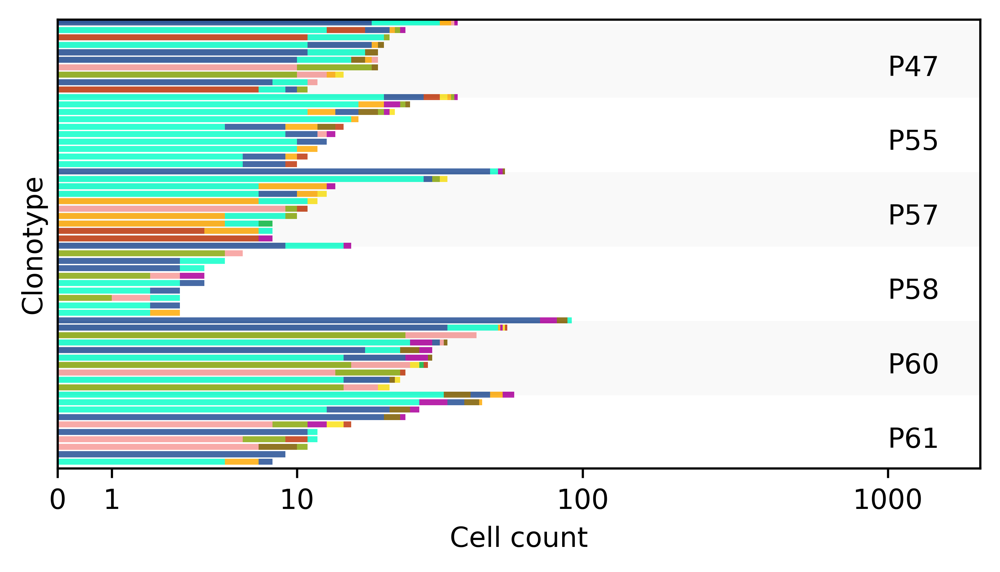

In [43]:
matplotlib.rcParams['figure.dpi'] = 600
df = df_all.copy()
df = df[df.cluster.isin(cd8_clusters)]
# df.loc[df.maxpred <= maxpred_bound, "cluster"] = "Unassigned"
df = df.dropna(subset=["clonotype", "cluster"])
df = df[df["clonotype"].apply(lambda x: "None" not in x)]

df_gb = df.groupby(["clonotype"]).barcode.nunique().to_frame()
df_gb_with_clus = df.groupby(["clonotype","cluster", "patient"]
                            ).barcode.nunique().to_frame().reset_index()
df_gb_with_clus = df_gb_with_clus.sort_values(by="barcode", ascending=False)
df_gb = df_gb_with_clus.groupby(["clonotype"]
                               ).agg({"barcode": "sum", 
                                      "cluster": "first", 
                                      "patient": "first"}).reset_index()

df_gb["main_cluster"] = df_gb.cluster


df_gb = df_gb.reset_index()

df_gb = df_gb.sort_values(by=["barcode", "main_cluster"], ascending=False)


keep = df_gb[(df_gb.main_cluster != "none")].clonotype.values
bars_tumor = []

clusters = ['CD8-FCGR3A', 'CD8-KLF2', 'CD8-GZMK', 'CD8-XCL1', 'CD8-SLC4A10', 
    'CD8-GZMH', 'CD8-LAYN', 'CD4/8-TOP2A', 'CD4/8-MCM5']
nb_top = 10


kpt_clones = list(df_gb[(df_gb.clonotype.isin(keep))
                       ].clonotype.head(nb_top).values)

patient_lst = ["P47", "P55", "P57", "P58", "P60", "P61"]
for pa in patient_lst:
    df_gbc = df_gb[df_gb.patient == pa]
    kpt_clones = list(df_gbc[(df_gbc.clonotype.isin(keep))
                           ].clonotype.head(nb_top).values)
    for kc in kpt_clones:
        dct_cl = df[(df.clonotype == kc)].groupby(
            "cluster").barcode.nunique().sort_values(ascending=False).to_dict()
        tmr_bar = []
        s = 0
        for cc in dct_cl:
            tmr_bar.append((color[cc], dct_cl[cc] + s))
            s += dct_cl[cc]
        tmr_bar = tmr_bar[::-1]
        bars_tumor.append(tmr_bar)


fig, ax = plt.subplots(figsize=(6, 3))

def scale(x):
    return np.log10(1 + x/2)

current_y = 0
for bt in bars_tumor:
    cl, hght = list(zip(*bt))
    ax.barh(width=scale(np.array(list(hght))), height=10/nb_top * 0.8, 
        y=[current_y + 0.1]*len(bt), color=cl)
    current_y -= 10/nb_top

ax.set_yticks([])
ax.set_xticks([-scale(1000), -scale(100),
               -scale(10), 
               -scale(1), scale(0), scale(1), 
               scale(10), scale(100),
              scale(1000),])
ax.set_xticklabels([1000, 100, 10, 1, 0, 1, 10, 100, 1000])

custom_lines = [Line2D([0], [0], color=color[a],
                       lw=4) for a in clusters]

ax.set_xlabel("Cell count")
ax.set_ylabel("Clonotype")
ax.axvline(0, color="k", lw=0.5)
xliml, xlimr = 0, 3

ax.set_xlim(xliml, xlimr)
ax.set_ylim(-60 + 0.2, 0.5)

for ii, pa in enumerate(patient_lst):
    ax.text(2.7, -7 - 10 * ii, pa, color="k")
    ax.fill([xliml, xlimr, xlimr, xliml],
           [-10 * ii, -10 * ii, -10 * (ii + 1), -10 * (ii + 1)],
           ("#CCCCCC" if ii%2 == 0 else "#FFFFFF"), alpha=0.1)

plt.show()

## Different Tissues

In [3]:
# Load the rdata containing cluster info, the clonotype info & the predictions for clustering in tissues

rdata = "../Data/Paul/CD3_4Tumors_4Blood_2Juxta"
samples = ["P57_Tumor", "P57_Blood", "P58_Tumor", "P58_Blood",
        "P60_Tumor", "P60_Blood", "P60_Juxta",
        "P61_Tumor", "P61_Blood","P61_Juxta"]
dfmaxpred = pd.read_csv("../Data/Paul/atlas.integrated_maxprediction.csv")
dfmaxpred["barcode"] = dfmaxpred.barcode.apply(lambda x: "_".join(x.split("_")[:-1]))
dfmaxpred = dfmaxpred.set_index("barcode")
maxpred_bound = 0.4663246

df_seq = {}
for key in samples: 
    # load clonotypes information
    df_seq[key] = pd.read_csv("../Data/" + key + "_VDJ/outs/filtered_contig_annotations_mixcr.csv")
    df_seq[key]["sample"] = key
    df_seq[key]["patient"] = key.split("_")[0]
    df_seq[key]["tissue"] = key.split("_")[1]
    
    # load informations from Paul's Rdata
    df_seq[key] = workflow.add_cluster_info(df_seq[key],
                               "../Data/Paul/atlas.integrated_clusters.csv",
                               key[:3],
                               name_column="cluster", 
                               metadata=rdata + "_metadata.csv",
                               umap=rdata + "_umap.csv", 
                               cca=rdata + "_pca.csv")
    df_seq[key]["maxpred"] = df_seq[key]["Unnamed: 0"].apply(lambda x: x.split("-")[0] + "_" + key).map(dfmaxpred.prediction_max)
    df_seq[key]["barcode"] = df_seq[key]["Unnamed: 0"].apply(lambda x: key + ":" + x[:16])
    df_seq[key]["raw_clonotype_id"] = df_seq[key].raw_clonotype_id.apply(lambda x: str(x) + "_" + key)
    df_seq[key]["cluster"] = df_seq[key].cluster.map(official_name)
    
      
# create global clonotypes for the patients
df_patient = {}
patients = list(set([s.split("_")[0] for s in samples]))
for p in patients:
    df_patient[p] = pd.concat([df_seq[s] for s in samples if s.split("_")[0] == p],
                              axis=0, sort=True)
    clone_method = "beta" # every clones sharing a TCR sequences are grouped together
    df_patient[p] = workflow.create_clonotypes(df_patient[p], method=clone_method)
    df_patient[p]["clonotype"] = (df_patient[p][
                "clonotype_" + clone_method].apply(lambda x: x if pd.isnull(x) else x + "_" + p))
    df_patient[p]["good_cluster_score"] = (df_patient[p].maxpred.fillna(1) > maxpred_bound)
    
df_all = pd.concat([
        df_patient[s] for s in df_patient], axis=0, sort=False)

In [9]:
## save expansion values
df_all["clonotype"].replace(r".*None.*", np.nan, inplace=True)
df_all[["patient", "tissue", "barcode", "clonotype"]].to_csv("barcode_clonotype_beta.csv.gz")

### Fig 6D

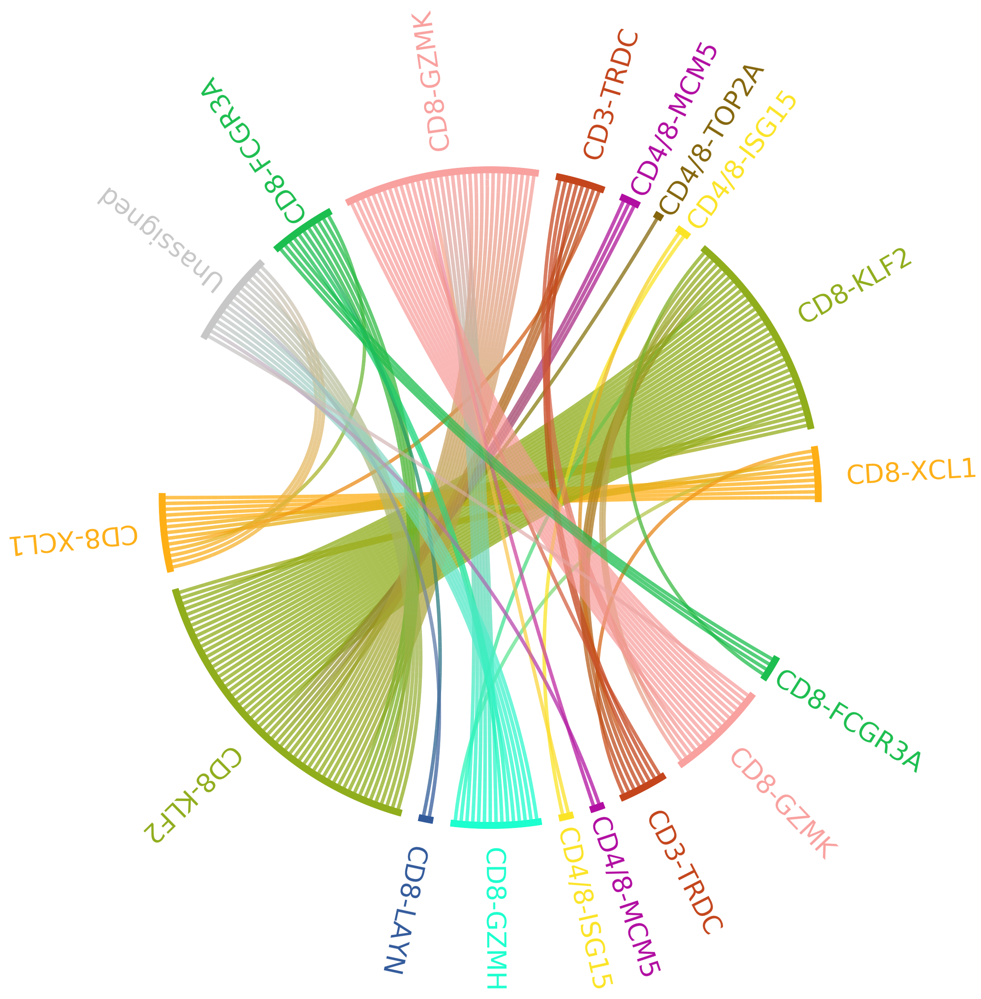

In [6]:
df = df_all.copy()
df = df[df.tissue.isin(["Blood", "Tumor"])]
df.loc[df.maxpred <= maxpred_bound, "cluster"] = "Unassigned"
df = df.dropna(subset=["clonotype", "cluster"])
df = df[df["clonotype"].apply(lambda x: "None" not in x)]

order_CD8 = ["Unassigned", "CD8-GZMK", "CD8-KLF2", "CD3-TRDC", "CD8-FCGR3A",
             "CD4/8-MCM5", "CD4/8-TOP2A", "CD4/8-ISG15", 
             "CD8-XCL1", "CD8-LAYN", "CD8-GZMH"]
df = df[df.cluster.isin(order_CD8)]
order_CD8 = list(df.cluster.unique())

clusters = [(k,o) for k,o in enumerate(order_CD8)]
dct_clusters = {o:k for k,o in enumerate(order_CD8)}

df["barcode_cluster_tissue"] = df.apply(lambda r: (r["barcode"], r["cluster"], r["tissue"]), axis=1)
dct = df.groupby("clonotype").barcode_cluster_tissue.apply(list).to_dict()
dct_barcode_to_tissue = df.set_index("barcode").tissue.to_dict()

source = []
target = []
tissues = []
for clo, bclus in dct.items():
    nb_clus = {(a, t):[] for a in order_CD8 for t in ["Tumor", "Blood", "Juxta"]}
    for b, c, t in bclus:
        nb_clus[c, t] += [b]

    clus = [a for a in nb_clus if len(set(nb_clus[a])) >= 1]

    if len(clus) >= 2 and clus[0][1] != clus[1][1]:
        source.append(clus[0][0] + "|||" + clus[0][1] + "|||" + clo)
        target.append(clus[1][0] + "|||" + clus[1][1] + "|||" + clo)
        source.append(clus[1][0] + "|||" + clus[1][1] + "|||" + clo)
        target.append(clus[0][0] + "|||" + clus[0][1] + "|||" + clo)

        
    

dfchord = pd.DataFrame({"source": source, "target":target})
dfchord["cluster"] = dfchord.source.apply(lambda x: x.split("|||")[0])
dfchord["tgt_cluster"] = dfchord.target.map(dfchord.set_index("source").cluster)
dfchord["tissue"] = dfchord.source.apply(lambda x: x.split("|||")[1])


palette = sns.color_palette([color[a] for a in order_CD8])

fig, ax = plt.subplots(figsize=(30, 30))
dfres = workflow.chord_diagram_section("source", "target", hue="cluster", section="tissue", 
                      hue_order=order_CD8,
                      order_section=["Blood",  "Tumor","Juxta"],
                       data=dfchord, ax=ax, chord_args={'linewidth':8, 'alpha':0.5}, spacing_section=0.08,
                     text_args={'fontsize':60}, radius_text=1.3, radius_text_section=1.5, no_chords=False, 
                      sub_circle=False, spacing=0.01, palette=palette,
                      spacing_between_circles=0.002,
                      thickness_circle=0.02,categorie_internal_chords=True, hatch_section=False,
                     section_text_args={'fontsize':40, 'alpha':0})
plt.show()

### Fig 6E

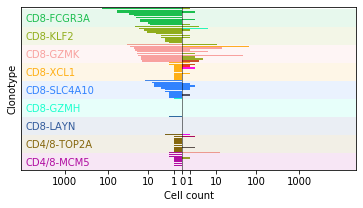

In [7]:

df = df_all.copy()
df = pd.concat([df_patient[p] for p in df_patient], axis=0, sort=True)
df.loc[df.maxpred <= maxpred_bound, "cluster"] = "Unassigned"
df = df.dropna(subset=["clonotype", "cluster"])
df = df[df["clonotype"].apply(lambda x: "None" not in x)]

df_gb = df.groupby(["clonotype", "tissue"]).barcode.nunique().to_frame()
df_gb_with_clus = df.groupby(["clonotype", "tissue", "cluster"]
                            ).barcode.nunique().to_frame().reset_index()
df_gb_with_clus = df_gb_with_clus.sort_values(by="barcode", ascending=False)
df_gb = df_gb_with_clus.groupby(["clonotype", "tissue"]
                               ).agg({"barcode": "sum", "cluster": "first"}).reset_index()


nb_tissue = df.groupby("clonotype").tissue.unique().to_dict()
df_gb = df_gb[df_gb.clonotype.map(nb_tissue).apply(lambda x: "Blood" in x)]

df_gb = df_gb.sort_values(by=["barcode", "cluster", "tissue"], ascending=False)

clos = []
bart = []
barb = []
hueclusters_bl = []
hueclusters_tm = []


clusters = ['CD8-FCGR3A', 'CD8-KLF2', 'CD8-GZMK', 'CD8-XCL1', 'CD8-SLC4A10', 
    'CD8-GZMH', 'CD8-LAYN', 'CD4/8-TOP2A', 'CD4/8-MCM5']



# s = 0

keep = df_gb[(df_gb.tissue == "Blood") & (df_gb.cluster != "none")].clonotype.values

for ii, cl in enumerate(clusters):
    df_gbc = df_gb[df_gb.cluster == cl]
    nclos = list(df_gbc[(df_gbc.tissue == "Blood") & (df_gbc.clonotype.isin(keep))
                       ].clonotype.head(10).values)
    hueclusters_bl += [cl for a in range(10)]
    clos += (nclos + ["none"]*(10 - len(nclos)))
        
dctb = df_gb[df_gb.tissue == "Blood"].set_index("clonotype").barcode.to_dict()
barb = [dctb[a] if a != "none" else 0 for a in clos ]
dctt = df_gb[df_gb.tissue == "Tumor"].set_index("clonotype").barcode.to_dict()
hueclusters_tm = df_gb[df_gb.tissue == "Tumor"].set_index("clonotype").cluster.to_dict()
for tt in dctb:
    if tt not in dctt:
        dctt[tt] = 0
        hueclusters_tm[tt] = "Unassigned"
bart = [dctt[a] if a != "none" else 0 for a in clos]
hueclusters_tm = [hueclusters_tm[a] if a != "none" else "Unassigned" for a in clos]
clos = np.array(clos)
bart = np.array(bart)
barb = np.array(barb) 


dctctocl = dict(zip(set(hueclusters_bl), range(len(set(hueclusters_bl)))))

def scale(x):
    return np.log10(1 + x/2)

fig, ax = plt.subplots(figsize=(6, 3))
colors = [color[a] for a in hueclusters_tm]
ax.barh(width=scale(np.array(list(bart))), y=[-a for a in range(len(clos))], color=colors)
    
colors = [color[a] for a in hueclusters_bl]
ax.barh(width=-scale(np.array(list(barb))), y=[-a for a in range(len(clos))], color=colors)

ax.set_yticks([])
ax.set_xticks([-scale(1000), -scale(100),
               -scale(10), 
               -scale(1), scale(0), scale(1), 
               scale(10), scale(100),
              scale(1000),])
ax.set_xticklabels([1000, 100, 10, 1, 0, 1, 10, 100, 1000])

hcs = list(set(hueclusters_bl))

custom_lines = [Line2D([0], [0], color=color[a],
                       lw=4) for a in hcs]

ax.set_xlabel("Cell count")
ax.set_ylabel("Clonotype")
ax.axvline(0, color="k", lw=0.5)
xliml, xlimr = -3.7, 4
ax.set_xlim(xliml, xlimr)
ax.set_ylim(-10*len(clusters) + 0.5, 1)
for ii, cl in enumerate(clusters):
    ax.text(-3.6, -7 - 10 * ii, cl, color=color[cl])
    ax.fill([xliml, xlimr, xlimr, xliml],
           [-10 * ii, -10 * ii, -10 * (ii + 1), -10 * (ii + 1)],
           color[cl], alpha=0.1)

plt.show()

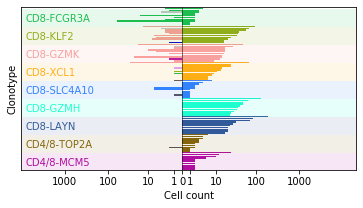

In [8]:
df = df_all.copy()
df = pd.concat([df_patient[p] for p in df_patient], axis=0, sort=True)
df.loc[df.maxpred <= maxpred_bound, "cluster"] = "Unassigned"
df = df.dropna(subset=["clonotype", "cluster"])
df = df[df["clonotype"].apply(lambda x: "None" not in x)]

df_gb = df.groupby(["clonotype", "tissue"]).barcode.nunique().to_frame()
df_gb_with_clus = df.groupby(["clonotype", "tissue", "cluster"]
                            ).barcode.nunique().to_frame().reset_index()
df_gb_with_clus = df_gb_with_clus.sort_values(by="barcode", ascending=False)
df_gb = df_gb_with_clus.groupby(["clonotype", "tissue"]
                               ).agg({"barcode": "sum", "cluster": "first"}).reset_index()



nb_tissue = df.groupby("clonotype").tissue.unique().to_dict()
df_gb = df_gb[df_gb.clonotype.map(nb_tissue).apply(lambda x: "Tumor" in x)]
df_gb = df_gb.sort_values(by=["barcode", "cluster", "tissue"], ascending=False)

clos = []
bart = []
barb = []
hueclusters_bl = []
hueclusters_tm = []
clusters = ['CD8-FCGR3A', 'CD8-KLF2', 'CD8-GZMK', 'CD8-XCL1', 'CD8-SLC4A10', 
    'CD8-GZMH', 'CD8-LAYN', 'CD4/8-TOP2A', 'CD4/8-MCM5']

keep = df_gb[(df_gb.tissue == "Tumor") & (df_gb.cluster != "none")].clonotype.values

for ii, cl in enumerate(clusters):
    df_gbc = df_gb[df_gb.cluster == cl]
    nclos = list(df_gbc[(df_gbc.tissue == "Tumor") & (df_gbc.clonotype.isin(keep))
                       ].clonotype.head(10).values)
    hueclusters_tm += [cl for a in range(10)]
    clos += nclos + ["none"] * (10 - len(nclos))

        
dctt = df_gb[df_gb.tissue == "Tumor"].set_index("clonotype").barcode.to_dict()
bart = [dctt[a] if a != "none" else 0 for a in clos]
dctb = df_gb[df_gb.tissue == "Blood"].set_index("clonotype").barcode.to_dict()
hueclusters_bl = df_gb[df_gb.tissue == "Blood"].set_index("clonotype").cluster.to_dict()
for tt in dctt:
    if tt not in dctb:
        dctb[tt] = 0
        hueclusters_bl[tt] = "Unassigned"
barb = [dctb[a] if a != "none" else 0 for a in clos]
hueclusters_bl = [hueclusters_bl[a] if a != "none" else "Unassigned" for a in clos]
clos = np.array(clos)
bart = np.array(bart)
barb = np.array(barb) 


def scale(x):
    return np.log10(1 + x/2)

fig, ax = plt.subplots(figsize=(6, 3))
colors = [color[a] for a in hueclusters_tm]
ax.barh(width=scale(np.array(list(bart))), 
        y=[-a for a in range(len(clos))], color=colors)
    
colors = [color[a] for a in hueclusters_bl]
ax.barh(width=-scale(np.array(list(barb))), 
        y=[-a for a in range(len(clos))], color=colors)

ax.set_yticks([])
ax.set_xticks([-scale(1000), -scale(100),
               -scale(10), 
               -scale(1), 0, scale(1), 
               scale(10), scale(100),
              scale(1000),])
ax.set_xticklabels([1000, 100, 10, 1, 0, 1, 10, 100, 1000])

hcs = list(set(hueclusters_bl))

custom_lines = [Line2D([0], [0], color=color[a],
                       lw=4) for a in hcs]

ax.set_xlabel("Cell count")
ax.set_ylabel("Clonotype")
ax.axvline(0, color="k", lw=0.5)
xliml, xlimr = -3.7, 4
ax.set_xlim(xliml, xlimr)
ax.set_ylim(-10*len(clusters)+0.5, 1)
for ii, cl in enumerate(clusters):
    ax.text(-3.6, -7 - 10 * ii, cl, color=color[cl])
    ax.fill([xliml, xlimr, xlimr, xliml],
           [-10 * ii, -10 * ii, -10 * (ii + 1), -10 * (ii + 1)],
           color[cl], alpha=0.1)

plt.show()

### Fig 6C (bottom)

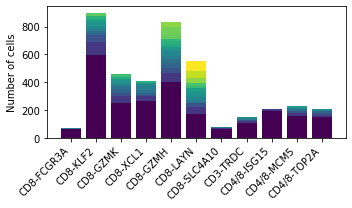

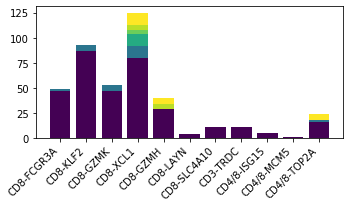

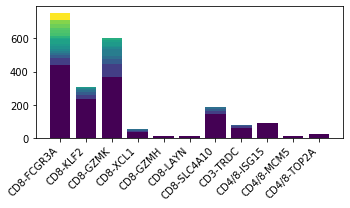

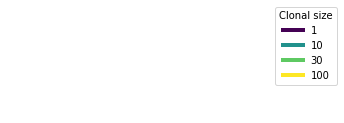

In [17]:
for tiss in ["Tumor", "Juxta", "Blood"]:
    df = df_all.copy()
    df = df[df.tissue == tiss]
    df = df[df.good_cluster_score > maxpred_bound]
    df["clonotype"] = df.raw_clonotype_id #this time, we take the "local" clonotype (10X)
    entropy = {}
    df = df[df.clonotype.apply(lambda x: "None" not in x)]
    df = df.dropna(subset=["cluster"])
    entropy = {}
    cluster = {}
    patient = {}
    i = 0
    clusters_considered = ["CD8-FCGR3A", "CD8-KLF2", "CD8-GZMK", 
                           "CD8-XCL1", "CD8-GZMH", "CD8-LAYN",
                           "CD8-SLC4A10", "CD3-TRDC", "CD4/8-ISG15", 
                           "CD4/8-MCM5", "CD4/8-TOP2A"]
    cluster_order = dict(zip(clusters_considered, range(len(clusters_considered))))

    dffig = df.groupby(["clonotype", "cluster"]).barcode.nunique().to_frame("Clonal_size").reset_index()
    dffig["Clusters"] = dffig.cluster
    dffig["Clusters_order"] = dffig.cluster.map(cluster_order)
    dffig["Number_of_cells"] = dffig.Clonal_size
    dffig.sort_values(by="Clonal_size", inplace=True)
    dftmp = pd.DataFrame()
    for c in clusters_considered:
        df = dffig[dffig.Clusters == c].copy()
        df["height"] = df.Number_of_cells.cumsum()
        dftmp = pd.concat([df, dftmp])
    dffig = dftmp.copy()
    #dffig["Clusters"] = dffig.Clusters.map(dct_names)
    dffig.sort_values(by=["Clusters_order", "Clonal_size"], inplace=True, ascending=False)
    
    
    
    dffig["clust_nb"] = dffig.Clusters.map(cluster_order)
    dffig["invClonalsize"] = -dffig.Clonal_size
    dffig.sort_values(by=["clust_nb", "invClonalsize"], inplace=True)

    # Initialize the figure
    
    cmap=cm.viridis
    fig, ax1 = plt.subplots(1, 1,figsize=(5, 3))

    from matplotlib.lines import Line2D
    custom_lines = [#Line2D([0], [0], color="xkcd:dirty purple", lw=4),
                    Line2D([0], [0], color=cmap(0), lw=4),
                    Line2D([0], [0], color=cmap(0.5), lw=4),
                    Line2D([0], [0], color=cmap(0.75), lw=4),
                    Line2D([0], [0], color=cmap(1.), lw=4)
                   ]
    
    ax1.bar(x=dffig["Clusters"], height=dffig["height"],
            color=cmap(np.log(dffig["Clonal_size"])/np.log(np.max(dffig.Clonal_size))), data=dffig)
    
    #dfnoclone = dffig[dffig.Clonal_size == 0].copy()
    #ax1.bar(x=dfnoclone["Clusters"], height=dfnoclone["height"], color="xkcd:dirty purple")
    plt.draw()
    ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha="right")
    if tiss == "Tumor":
        ax1.set_ylabel("Number of cells")
    plt.tight_layout()
    plt.show()
    

import matplotlib.cm as cm
cmap=cm.viridis
fig, ax = plt.subplots(1, 1,figsize=(5, 2))

from matplotlib.lines import Line2D
custom_lines = [#Line2D([0], [0], color="xkcd:dirty purple", lw=4),
                Line2D([0], [0], color=cmap(0), lw=4),
                Line2D([0], [0], color=cmap(0.5), lw=4),
                Line2D([0], [0], color=cmap(0.75), lw=4),
                Line2D([0], [0], color=cmap(1.), lw=4)
               ]
ax.legend(custom_lines, ["1", "10", "30", "100"],
          title="Clonal size",bbox_to_anchor=(1.2, 1.05))
plt.gca().set_axis_off()
plt.show()

In [ ]:
import scanpy as sc
adata = sc.read_loom("../Data/Paul/CD3_11tumors_subset_clean.loom")
adata = adata[adata.obs["ClusterName"].map(official_name).isin(["CD8-FCGR3A", "CD8-KLF2", "CD8-GZMK", 
                                                  "CD8-GZMH", "CD8-LAYN", "CD8-XCL1"])]
sc.pp.neighbors(adata, n_neighbors=4, n_pcs=20, use_rep='pca_cell_embeddings')
sc.tl.draw_graph(adata)
sc.tl.louvain(adata, resolution=1.0)
adata.obs["cluster_name"] = adata.obs.ClusterName.map(official_name)

sc.tl.paga(adata, groups='cluster_name')
adata.uns['cluster_name_colors'] = ["#1CBE4F", # fcgr3a
                                    "#1CFFCE", # gzmh
                                    "#F8A19F", # gzmk
                                    "#90AD1C", # klf2
                                    "#325A9B", # layn
                                    "#FEAF16"] # xcl1
sc.pl.paga(adata, color='cluster_name',
           threshold=0.15, fontsize=15, frameon=False,
           pos=1/4*np.array([[0, 0], [0, -0.5], [-0.25, -0.25], 
                         [-0.5, -0.5], [0.25, -0.75], [-0.25, -0.75]]))

## Supplementary

In [ ]:
sc.pl.paga_compare(
    adata, threshold=0.15, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=0, fontsize=12, frameon=False, edges=True)


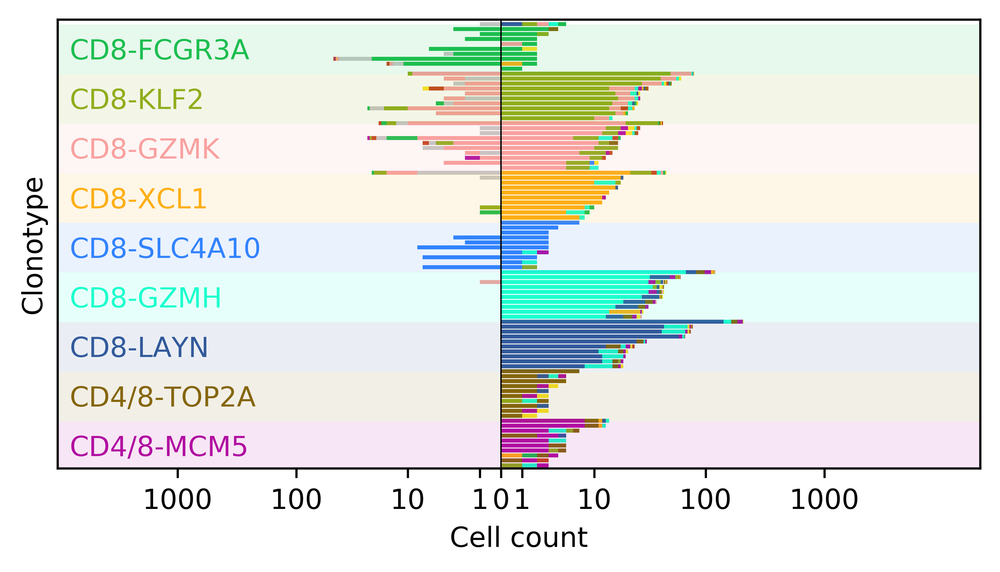

In [19]:
matplotlib.rcParams['figure.dpi'] = 600
df = df_all.copy()
df = pd.concat([df_patient[p] for p in df_patient], axis=0, sort=True)
df = df[df.cluster.isin(cd8_clusters)]
df.loc[df.maxpred <= maxpred_bound, "cluster"] = "Unassigned"
df = df.dropna(subset=["clonotype", "cluster"])
df = df[df["clonotype"].apply(lambda x: "None" not in x)]

df_gb = df.groupby(["clonotype", "tissue"]).barcode.nunique().to_frame()
df_gb_with_clus = df.groupby(["clonotype", "tissue", "cluster"]
                            ).barcode.nunique().to_frame().reset_index()
df_gb_with_clus = df_gb_with_clus.sort_values(by="barcode", ascending=False)
df_gb = df_gb_with_clus.groupby(["clonotype", "tissue"]
                               ).agg({"barcode": "sum", "cluster": "first"}).reset_index()

df_gb["main_cluster"] = df_gb.cluster


df_gb = df_gb.reset_index()

nb_tissue = df.groupby("clonotype").tissue.unique().to_dict()
df_gb = df_gb[df_gb.clonotype.map(nb_tissue).apply(lambda x: "Tumor" in x)]
df_gb = df_gb.sort_values(by=["barcode", "main_cluster", "tissue"], ascending=False)


keep = df_gb[(df_gb.tissue == "Tumor") & (df_gb.main_cluster != "none")].clonotype.values
bars_tumor, bars_blood = [], []

clusters = ['CD8-FCGR3A', 'CD8-KLF2', 'CD8-GZMK', 'CD8-XCL1', 'CD8-SLC4A10', 
    'CD8-GZMH', 'CD8-LAYN', 'CD4/8-TOP2A', 'CD4/8-MCM5']
nb_top = 10

for cl in clusters:
    df_gbc = df_gb[df_gb.main_cluster == cl]
    kpt_clones = list(df_gbc[(df_gbc.tissue == "Tumor") & (df_gbc.clonotype.isin(keep))
                           ].clonotype.head(nb_top).values)
    for kc in kpt_clones:
        dct_cl = df[(df.tissue == "Tumor") 
                    & (df.clonotype == kc)].groupby(
            "cluster").barcode.nunique().sort_values(ascending=False).to_dict()
        tmr_bar = []
        s = 0
        for cc in dct_cl:
            tmr_bar.append((color[cc], dct_cl[cc] + s))
            s += dct_cl[cc]
        tmr_bar = tmr_bar[::-1]
        bars_tumor.append(tmr_bar)
        
        dct_cl = df[(df.tissue == "Blood") 
                    & (df.clonotype == kc)].groupby(
            "cluster").barcode.nunique().sort_values(ascending=False).to_dict()
        bld_bar = []
        s = 0
        for cc in dct_cl:
            bld_bar.append((color[cc], dct_cl[cc] + s))
            s += dct_cl[cc] 
        bld_bar = bld_bar[::-1]
        bars_blood.append(bld_bar)

fig, ax = plt.subplots(figsize=(6, 3))
#colors = [color[a] for a in hueclusters_tm]


def scale(x):
    return np.log10(1 + x/2)

current_y = 0
for bt, bb in zip(bars_tumor, bars_blood):
    cl, hght = list(zip(*bt))
    ax.barh(width=scale(np.array(list(hght))), height=10/nb_top * 0.8, 
        y=[current_y + 0.1]*len(bt), color=cl)
    
    if bb != []:
        cl, hght = list(zip(*bb))
        ax.barh(width=-scale(np.array(list(hght))), height=10/nb_top * 0.8, 
        y=[current_y + 0.1]*len(bb), color=cl)
    current_y -= 10/nb_top

ax.set_yticks([])
ax.set_xticks([-scale(1000), -scale(100),
               -scale(10), 
               -scale(1), scale(0), scale(1), 
               scale(10), scale(100),
              scale(1000),])
ax.set_xticklabels([1000, 100, 10, 1, 0, 1, 10, 100, 1000])

custom_lines = [Line2D([0], [0], color=color[a],
                       lw=4) for a in clusters]

ax.set_xlabel("Cell count")
ax.set_ylabel("Clonotype")
ax.axvline(0, color="k", lw=0.5)
xliml, xlimr = -3.7, 4

ax.set_xlim(xliml, xlimr)
ax.set_ylim(-10*len(clusters)+0.5, 1)
for ii, cl in enumerate(clusters):
    ax.text(-3.6, -7 - 10 * ii, cl, color=color[cl])
    ax.fill([xliml, xlimr, xlimr, xliml],
           [-10 * ii, -10 * ii, -10 * (ii + 1), -10 * (ii + 1)],
           color[cl], alpha=0.1)

plt.show()       


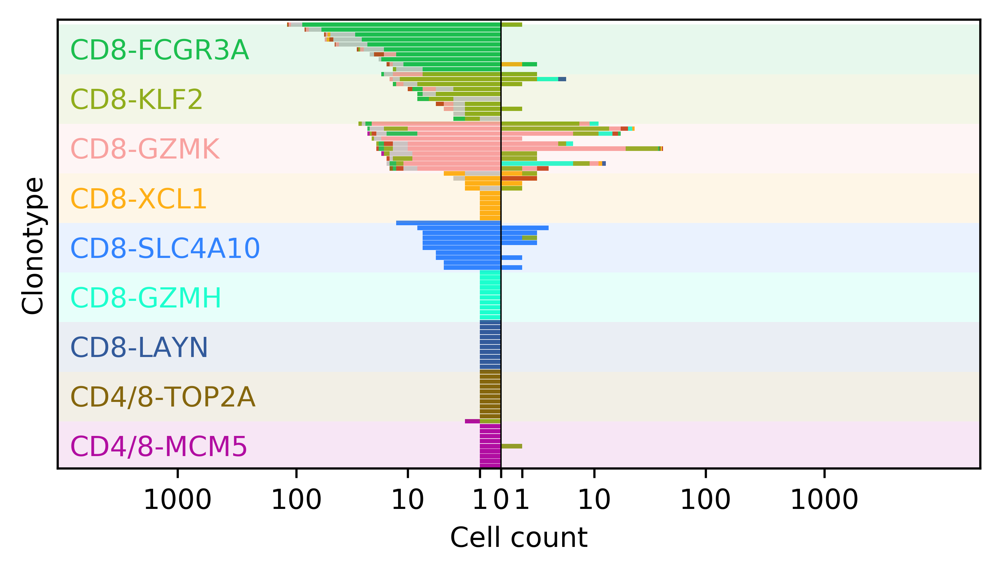

In [20]:
# don't try to make sense of this (exchanged blood & tumor, compared to previous graph)
df = df_all.copy()
df = pd.concat([df_patient[p] for p in df_patient], axis=0, sort=True)
df.loc[df.maxpred <= maxpred_bound, "cluster"] = "Unassigned"
df = df.dropna(subset=["clonotype", "cluster"])
df = df[df.cluster.isin(cd8_clusters)]
df = df[df["clonotype"].apply(lambda x: "None" not in x)]

df_gb = df.groupby(["clonotype", "tissue"]).barcode.nunique().to_frame()
df_gb_with_clus = df.groupby(["clonotype", "tissue", "cluster"]
                            ).barcode.nunique().to_frame().reset_index()
df_gb_with_clus = df_gb_with_clus.sort_values(by="barcode", ascending=False)
df_gb = df_gb_with_clus.groupby(["clonotype", "tissue"]
                               ).agg({"barcode": "sum", "cluster": "first"}).reset_index()

df_gb["main_cluster"] = df_gb.cluster


df_gb = df_gb.reset_index()

nb_tissue = df.groupby("clonotype").tissue.unique().to_dict()
df_gb = df_gb[df_gb.clonotype.map(nb_tissue).apply(lambda x: "Blood" in x)]
df_gb = df_gb.sort_values(by=["barcode", "main_cluster", "tissue"], ascending=False)


keep = df_gb[(df_gb.tissue == "Blood") & (df_gb.main_cluster != "none")].clonotype.values
bars_tumor, bars_blood = [], []

clusters = ['CD8-FCGR3A', 'CD8-KLF2', 'CD8-GZMK', 'CD8-XCL1', 'CD8-SLC4A10', 
    'CD8-GZMH', 'CD8-LAYN', 'CD4/8-TOP2A', 'CD4/8-MCM5']
nb_top = 10

for cl in clusters:
    df_gbc = df_gb[df_gb.main_cluster == cl]
    kpt_clones = list(df_gbc[(df_gbc.tissue == "Blood") & (df_gbc.clonotype.isin(keep))
                           ].clonotype.head(nb_top).values)
    for kc in kpt_clones:
        dct_cl = df[(df.tissue == "Blood") 
                    & (df.clonotype == kc)].groupby(
            "cluster").barcode.nunique().sort_values(ascending=False).to_dict()
        tmr_bar = []
        s = 0
        for cc in dct_cl:
            tmr_bar.append((color[cc], dct_cl[cc] + s))
            s += dct_cl[cc]
        tmr_bar = tmr_bar[::-1]
        bars_tumor.append(tmr_bar)
        
        dct_cl = df[(df.tissue == "Tumor") 
                    & (df.clonotype == kc)].groupby(
            "cluster").barcode.nunique().sort_values(ascending=False).to_dict()
        bld_bar = []
        s = 0
        for cc in dct_cl:
            bld_bar.append((color[cc], dct_cl[cc] + s))
            s += dct_cl[cc] 
        bld_bar = bld_bar[::-1]
        bars_blood.append(bld_bar)

fig, ax = plt.subplots(figsize=(6, 3))


def scale(x):
    return np.log10(1 + x/2)

current_y = 0
for bt, bb in zip(bars_tumor, bars_blood):
    cl, hght = list(zip(*bt))
    ax.barh(width=-scale(np.array(list(hght))), height=10/nb_top * 0.9, 
        y=[current_y]*len(bt), color=cl)
    
    if bb != []:
        cl, hght = list(zip(*bb))
        ax.barh(width=scale(np.array(list(hght))), height=10/nb_top * 0.9, 
        y=[current_y]*len(bb), color=cl)
    current_y -= 10/nb_top

ax.set_yticks([])
ax.set_xticks([-scale(1000), -scale(100),
               -scale(10), 
               -scale(1), scale(0), scale(1), 
               scale(10), scale(100),
              scale(1000),])
ax.set_xticklabels([1000, 100, 10, 1, 0, 1, 10, 100, 1000])

custom_lines = [Line2D([0], [0], color=color[a],
                       lw=4) for a in clusters]

ax.set_xlabel("Cell count")
ax.set_ylabel("Clonotype")
ax.axvline(0, color="k", lw=0.5)
xliml, xlimr = -3.7, 4
ax.set_xlim(xliml, xlimr)
ax.set_ylim(-10*len(clusters)+0.5, 1)
for ii, cl in enumerate(clusters):
    ax.text(-3.6, -7 - 10 * ii, cl, color=color[cl])
    ax.fill([xliml, xlimr, xlimr, xliml],
           [-10 * ii, -10 * ii, -10 * (ii + 1), -10 * (ii + 1)],
           color[cl], alpha=0.1)

plt.show()       


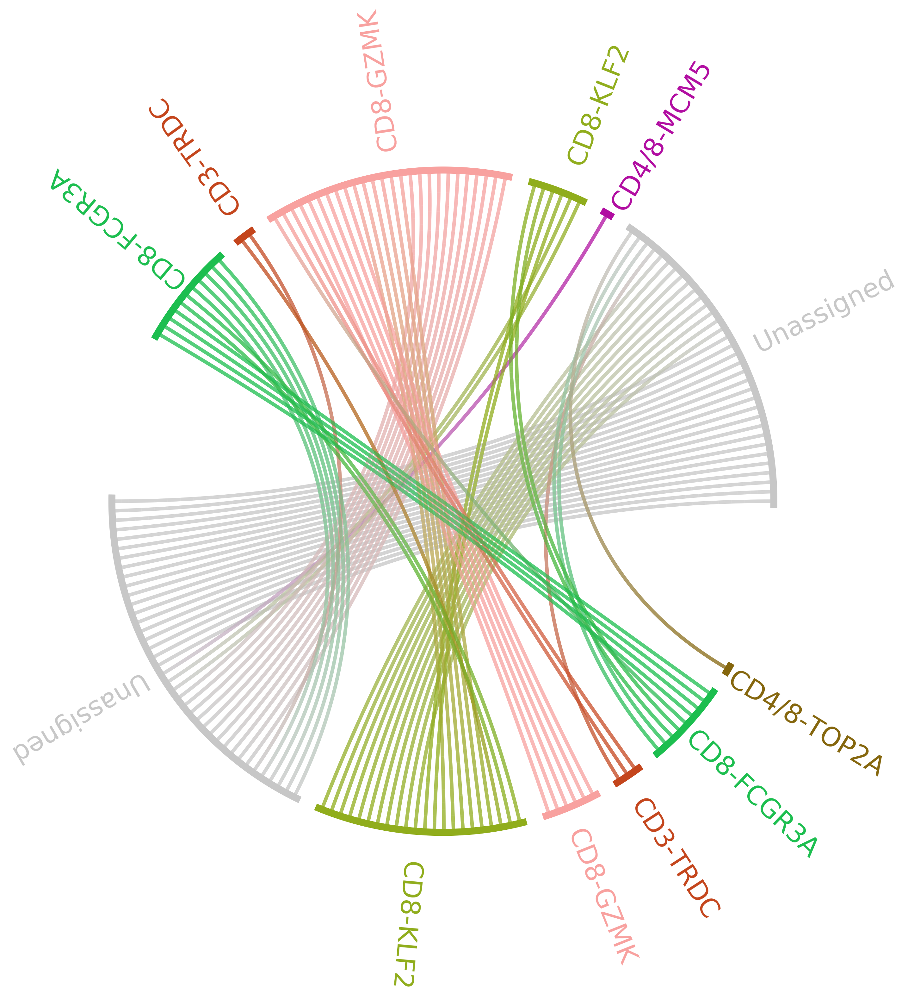

In [21]:
matplotlib.rcParams['figure.dpi'] = 100 #reduce dpi to copy-paste

df = df_all.copy()
df = df[df.tissue.isin(["Blood", "Juxta"])]
df.loc[df.maxpred <= maxpred_bound, "cluster"] = "Unassigned"
df = df.dropna(subset=["clonotype", "cluster"])
df = df[df["clonotype"].apply(lambda x: "None" not in x)]

order_CD8 = ["Unassigned", "CD8-GZMK", "CD8-KLF2", "CD3-TRDC", "CD8-FCGR3A",
             "CD4/8-MCM5", "CD4/8-TOP2A", "CD4/8-ISG15", 
             "CD8-XCL1", "CD8-LAYN", "CD8-GZMH"]
df = df[df.cluster.isin(order_CD8)]
order_CD8 = list(df.cluster.unique())

clusters = [(k,o) for k,o in enumerate(order_CD8)]
dct_clusters = {o:k for k,o in enumerate(order_CD8)}

df["barcode_cluster_tissue"] = df.apply(lambda r: (r["barcode"], r["cluster"], r["tissue"]), axis=1)
dct = df.groupby("clonotype").barcode_cluster_tissue.apply(list).to_dict()
dct_barcode_to_tissue = df.set_index("barcode").tissue.to_dict()

source = []
target = []
tissues = []
for clo, bclus in dct.items():
    nb_clus = {(a, t):[] for a in order_CD8 for t in ["Tumor", "Blood", "Juxta"]}
    for b, c, t in bclus:
        nb_clus[c, t] += [b]

    clus = [a for a in nb_clus if len(set(nb_clus[a])) >= 1]

    if len(clus) >= 2 and clus[0][1] != clus[1][1]:
        source.append(clus[0][0] + "|||" + clus[0][1] + "|||" + clo)
        target.append(clus[1][0] + "|||" + clus[1][1] + "|||" + clo)
        source.append(clus[1][0] + "|||" + clus[1][1] + "|||" + clo)
        target.append(clus[0][0] + "|||" + clus[0][1] + "|||" + clo)

        
    

dfchord = pd.DataFrame({"source": source, "target":target})
dfchord["cluster"] = dfchord.source.apply(lambda x: x.split("|||")[0])
dfchord["tgt_cluster"] = dfchord.target.map(dfchord.set_index("source").cluster)
dfchord["tissue"] = dfchord.source.apply(lambda x: x.split("|||")[1])


palette = sns.color_palette([color[a] for a in order_CD8])

fig, ax = plt.subplots(figsize=(30, 30))
dfres = workflow.chord_diagram_section("source", "target", hue="cluster", section="tissue", 
                      hue_order=order_CD8,
                      order_section=["Blood",  "Tumor","Juxta"],
                       data=dfchord, ax=ax, chord_args={'linewidth':8, 'alpha':0.5}, spacing_section=0.08,
                     text_args={'fontsize':60}, radius_text=1.3, radius_text_section=1.5, no_chords=False, 
                      sub_circle=False, spacing=0.01, palette=palette,
                      spacing_between_circles=0.002,
                      thickness_circle=0.02,categorie_internal_chords=True, hatch_section=False,
                     section_text_args={'fontsize':40, 'alpha':0})
plt.show()

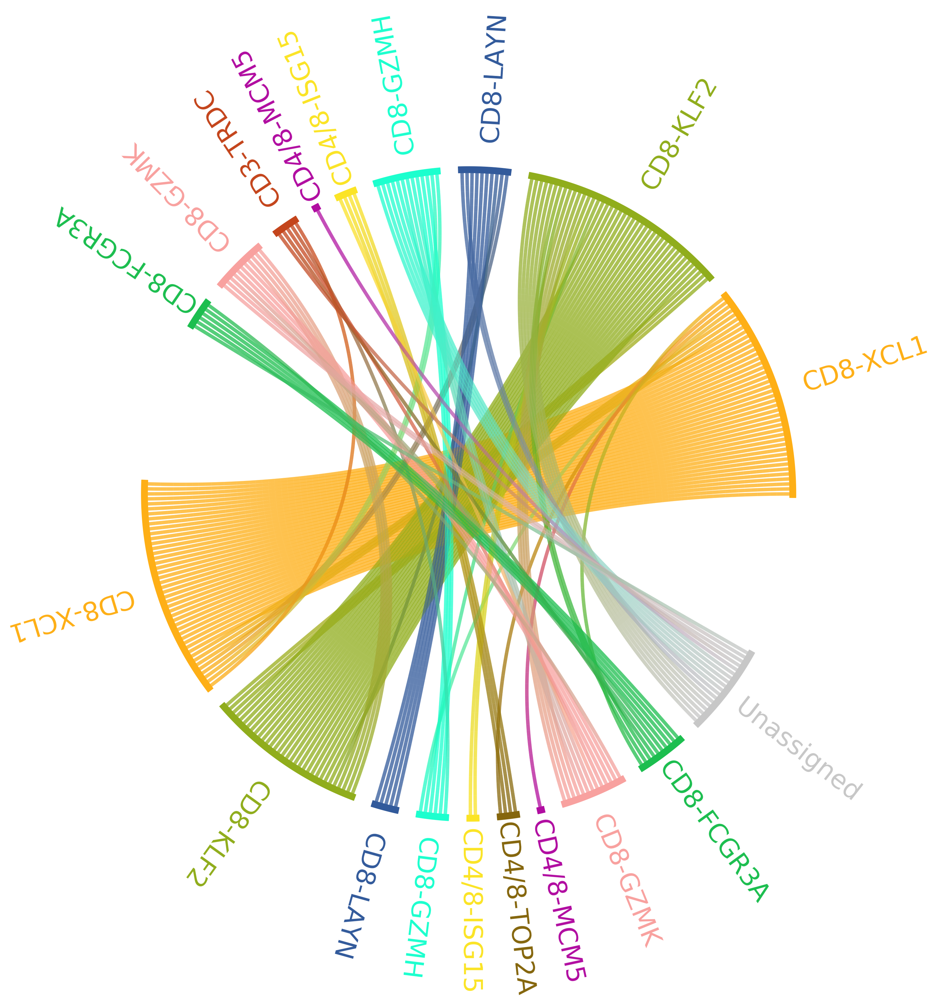

In [22]:
matplotlib.rcParams['figure.dpi'] = 100 #reduce dpi to copy-paste

df = df_all.copy()
df = df[df.tissue.isin(["Juxta", "Tumor"])]
df.loc[df.maxpred <= maxpred_bound, "cluster"] = "Unassigned"
df = df.dropna(subset=["clonotype", "cluster"])
df = df[df["clonotype"].apply(lambda x: "None" not in x)]

order_CD8 = ["Unassigned", "CD8-GZMK", "CD8-KLF2", "CD3-TRDC", "CD8-FCGR3A",
             "CD4/8-MCM5", "CD4/8-TOP2A", "CD4/8-ISG15", 
             "CD8-XCL1", "CD8-LAYN", "CD8-GZMH"]
df = df[df.cluster.isin(order_CD8)]
order_CD8 = list(df.cluster.unique())

clusters = [(k,o) for k,o in enumerate(order_CD8)]
dct_clusters = {o:k for k,o in enumerate(order_CD8)}

df["barcode_cluster_tissue"] = df.apply(lambda r: (r["barcode"], r["cluster"], r["tissue"]), axis=1)
dct = df.groupby("clonotype").barcode_cluster_tissue.apply(list).to_dict()
dct_barcode_to_tissue = df.set_index("barcode").tissue.to_dict()

source = []
target = []
tissues = []
for clo, bclus in dct.items():
    nb_clus = {(a, t):[] for a in order_CD8 for t in ["Tumor", "Blood", "Juxta"]}
    for b, c, t in bclus:
        nb_clus[c, t] += [b]

    clus = [a for a in nb_clus if len(set(nb_clus[a])) >= 1]

    if len(clus) >= 2 and clus[0][1] != clus[1][1]:
        source.append(clus[0][0] + "|||" + clus[0][1] + "|||" + clo)
        target.append(clus[1][0] + "|||" + clus[1][1] + "|||" + clo)
        source.append(clus[1][0] + "|||" + clus[1][1] + "|||" + clo)
        target.append(clus[0][0] + "|||" + clus[0][1] + "|||" + clo)

        
    

dfchord = pd.DataFrame({"source": source, "target":target})
dfchord["cluster"] = dfchord.source.apply(lambda x: x.split("|||")[0])
dfchord["tgt_cluster"] = dfchord.target.map(dfchord.set_index("source").cluster)
dfchord["tissue"] = dfchord.source.apply(lambda x: x.split("|||")[1])


palette = sns.color_palette([color[a] for a in order_CD8])

fig, ax = plt.subplots(figsize=(30, 30))
dfres = workflow.chord_diagram_section("source", "target", hue="cluster", section="tissue", 
                      hue_order=order_CD8,
                      order_section=["Blood",  "Tumor","Juxta"],
                       data=dfchord, ax=ax, chord_args={'linewidth':8, 'alpha':0.5}, spacing_section=0.08,
                     text_args={'fontsize':60}, radius_text=1.3, radius_text_section=1.5, no_chords=False, 
                      sub_circle=False, spacing=0.01, palette=palette,
                      spacing_between_circles=0.002,
                      thickness_circle=0.02,categorie_internal_chords=True, hatch_section=False,
                     section_text_args={'fontsize':40, 'alpha':0})
plt.show()